# PRIMER PARCIAL

In [2]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D

# 1. PARTE 1

In [4]:
#Redireccionar nuestra localización a donde està el archivo de irir
path = r"C:\Users\oswal\OneDrive\Documentos\GitHub\Neurociencias-2025-2\S03_datasets\iris\iris.csv"

In [5]:
df = pd.read_csv(path)
df.head()

,Sepal.Length,Sepal.Width,Petal.Length,Petal.Width,Species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [6]:
import seaborn as sns

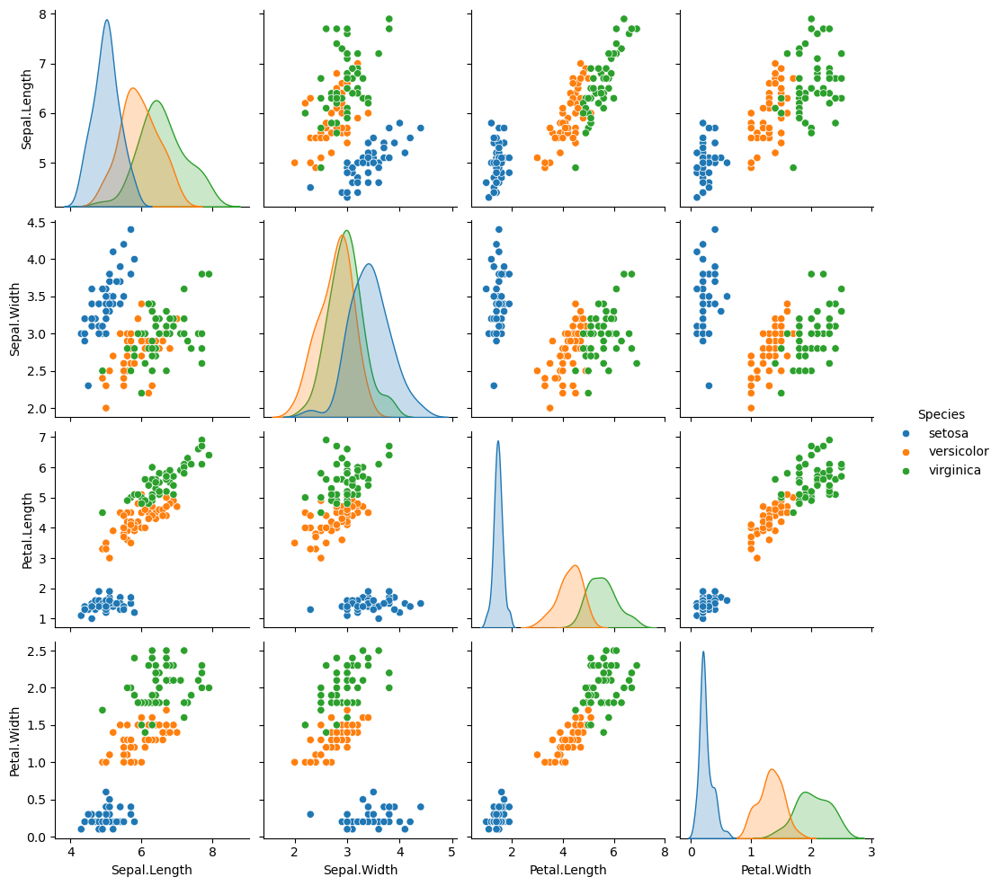

In [7]:
X = df.iloc[:, :4] #filtrar solo las 4 columnas numericas
sns.pairplot(df, hue="Species") #mostrar la correlacion entre las cuatro variables pero solo de 2 en 2, agregando hue agregamos color a
#cada grupo de datos, ya que al especificar que sea por especies le estamos diciendo que no son un solo conjunto sino que todos los
# que correspondan a la cantidad de grupos en Species

In [8]:
X

,Sepal.Length,Sepal.Width,Petal.Length,Petal.Width
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2
...,...,...,...,...
145,6.7,3.0,5.2,2.3
146,6.3,2.5,5.0,1.9
147,6.5,3.0,5.2,2.0
148,6.2,3.4,5.4,2.3


In [9]:
#Calcular los vectores y valores propios a partir de la matriz de covarianza (la diferencia entre la de 
#correlación es que no es estrictamente necesario que tengan la misma dimensión).
#Porcentaje de aporte de las variables y cuyantas ocupamos para representar el 85% de datos.

In [10]:
df['Species'].unique() #nos dice cuales elementos definen Species

array(['setosa', 'versicolor', 'virginica'], dtype=object)

In [11]:
#Primero Normalizamos los datos de nuestros array
np.mean(X, axis=0), np.std(X, axis=0)

(Sepal.Length    5.843333
 Sepal.Width     3.057333
 Petal.Length    3.758000
 Petal.Width     1.199333
 dtype: float64,
 Sepal.Length    0.825301
 Sepal.Width     0.434411
 Petal.Length    1.759404
 Petal.Width     0.759693
 dtype: float64)

In [12]:
X_std = (X - np.mean(X, axis=0))/np.std(X, axis=0)
X_std

,Sepal.Length,Sepal.Width,Petal.Length,Petal.Width
0,-0.900681,1.019004,-1.340227,-1.315444
1,-1.143017,-0.131979,-1.340227,-1.315444
2,-1.385353,0.328414,-1.397064,-1.315444
3,-1.506521,0.098217,-1.283389,-1.315444
4,-1.021849,1.249201,-1.340227,-1.315444
...,...,...,...,...
145,1.038005,-0.131979,0.819596,1.448832
146,0.553333,-1.282963,0.705921,0.922303
147,0.795669,-0.131979,0.819596,1.053935
148,0.432165,0.788808,0.933271,1.448832


In [13]:
X_std.iloc[:, 0] #Index location siempre que trabajemos con un dataframe, o sea agarrate todos los indices 

0     -0.900681
1     -1.143017
2     -1.385353
3     -1.506521
4     -1.021849
         ...   
145    1.038005
146    0.553333
147    0.795669
148    0.432165
149    0.068662
Name: Sepal.Length, Length: 150, dtype: float64

In [14]:
X_std.describe() #Para corroborar la normalización

,Sepal.Length,Sepal.Width,Petal.Length,Petal.Width
count,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02
mean,-4.736952e-16,-8.052818e-16,-2.842171e-16,-4.736952e-16
std,1.003350e+00,1.003350e+00,1.003350e+00,1.003350e+00
min,-1.870024e+00,-2.433947e+00,-1.567576e+00,-1.447076e+00
25%,-9.006812e-01,-5.923730e-01,-1.226552e+00,-1.183812e+00
50%,-5.250608e-02,-1.319795e-01,3.364776e-01,1.325097e-01
75%,6.745011e-01,5.586108e-01,7.627583e-01,7.906707e-01
max,2.492019e+00,3.090775e+00,1.785832e+00,1.712096e+00


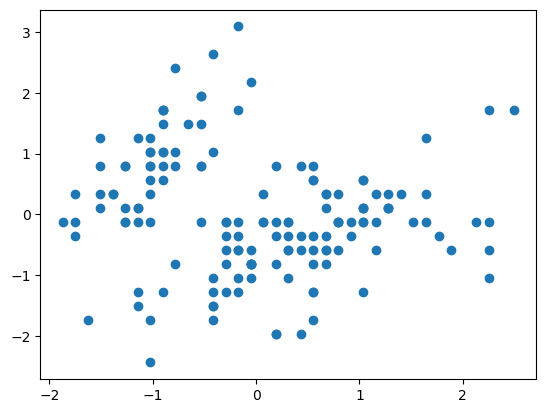

In [15]:
plt.scatter(X_std.iloc[:, 0], X_std.iloc[:, 1])

# Calculo de la Matriz covarianza

In [17]:
X_mean = np.mean(X_std, axis=0)
X_mean

Sepal.Length   -4.736952e-16
Sepal.Width    -8.052818e-16
Petal.Length   -2.842171e-16
Petal.Width    -4.736952e-16
dtype: float64

In [18]:
cov_matrix = (X_std - X_mean).T.dot((X_std - X_mean))/(X_std.shape[0]-1) #primer metodo para sacar matriz cov
cov_matrix

,Sepal.Length,Sepal.Width,Petal.Length,Petal.Width
Sepal.Length,1.006711,-0.118359,0.877604,0.823431
Sepal.Width,-0.118359,1.006711,-0.431316,-0.368583
Petal.Length,0.877604,-0.431316,1.006711,0.969328
Petal.Width,0.823431,-0.368583,0.969328,1.006711


In [19]:
eig_vals, eig_vecs = np.linalg.eig(cov_matrix)
eig_vals, eig_vecs

(array([2.93808505, 0.9201649 , 0.14774182, 0.02085386]),
 array([[ 0.52106591, -0.37741762, -0.71956635,  0.26128628],
        [-0.26934744, -0.92329566,  0.24438178, -0.12350962],
        [ 0.5804131 , -0.02449161,  0.14212637, -0.80144925],
        [ 0.56485654, -0.06694199,  0.63427274,  0.52359713]]))

# Calculo de valores y vectores propios con la matriz de covarianza

In [21]:
#Manera corta de calcularlos (la del rpofe)
eig_vals, eig_vectors = np.linalg.eig(cov_matrix)
print("Valores propios \n%s"%eig_vals)
print("Vectores propios \n%s"%eig_vectors)

Valores propios 
[2.93808505 0.9201649  0.14774182 0.02085386]
Vectores propios 
[[ 0.52106591 -0.37741762 -0.71956635  0.26128628]
 [-0.26934744 -0.92329566  0.24438178 -0.12350962]
 [ 0.5804131  -0.02449161  0.14212637 -0.80144925]
 [ 0.56485654 -0.06694199  0.63427274  0.52359713]]


In [22]:
eig_vals, eig_vectors = np.linalg.eig(np.cov(X_std.T))
print("Valores propios \n%s"%eig_vals)
print("Vectores propios \n%s"%eig_vectors)

Valores propios 
[2.93808505 0.9201649  0.14774182 0.02085386]
Vectores propios 
[[ 0.52106591 -0.37741762 -0.71956635  0.26128628]
 [-0.26934744 -0.92329566  0.24438178 -0.12350962]
 [ 0.5804131  -0.02449161  0.14212637 -0.80144925]
 [ 0.56485654 -0.06694199  0.63427274  0.52359713]]


In [23]:
#Manera rápida del profe para sacar el % de cada vector
eigen_pairs = [(np.abs(eig_vals[i]), eig_vectors[:,i]) for i in range(len(eig_vals))]
eigen_pairs

[(2.9380850501999918,
  array([ 0.52106591, -0.26934744,  0.5804131 ,  0.56485654])),
 (0.9201649041624878,
  array([-0.37741762, -0.92329566, -0.02449161, -0.06694199])),
 (0.1477418210449483,
  array([-0.71956635,  0.24438178,  0.14212637,  0.63427274])),
 (0.020853862176462436,
  array([ 0.26128628, -0.12350962, -0.80144925,  0.52359713]))]

In [24]:
# Ordenamos de mayor a menor
eigen_pairs.sort(reverse=True)

# Calculamos los porcentajes
total_sum = sum(eig_vals)
var_exp = [(i/total_sum)*100 for i in sorted(eig_vals, reverse=True)]
cum_var_exp = np.cumsum(var_exp)

In [25]:
print('El porcentaje de información que cada valor propio aporta es:')
var_exp

El porcentaje de información que cada valor propio aporta es:


[72.96244541329983, 22.850761786701792, 3.6689218892828848, 0.5178709107154842]

In [26]:
print('El porcentaje de información acumulado es:')
cum_var_exp

El porcentaje de información acumulado es:


array([ 72.96244541,  95.8132072 ,  99.48212909, 100.        ])

In [27]:
#Sacar el porcentaje de cada uno de los vectores 
total_sum = np.sum(eig_vals)

val_porc_eig_val_1 = eig_vals[0]/total_sum * 100 #Los corchetes indican que estamos trabajando ahuevo con arreglos, el 0 es la posición 
val_porc_eig_val_2 = eig_vals[1]/total_sum * 100 #1 del array, nuestro array en este caso es eig_vals y [0] le estamos diciendo
val_porc_eig_val_3 = eig_vals[2]/total_sum * 100 #que tome el primer dato de ese array, y así susesivamente
val_porc_eig_val_4 = eig_vals[3]/total_sum * 100
val_porc_eig_val_1, val_porc_eig_val_2, val_porc_eig_val_3, val_porc_eig_val_4
#En este caso podemos ver que sólo los 2 primeros datos del array (valor propio 1 y 2) expresan el 94% de nuestros datos.


(72.96244541329983, 22.850761786701792, 3.6689218892828848, 0.5178709107154842)

In [28]:
#Metodo rápido del profe, lo hago para ver que me diera lo mismo
total_sum = sum(eig_vals)
var_exp = [(i/total_sum)*100 for i in sorted(eig_vals, reverse=True)]
cum_var_exp = np.cumsum(var_exp)

In [29]:
print('El porcentaje de información que cada valor propio aporta es:')
var_exp

El porcentaje de información que cada valor propio aporta es:


[72.96244541329983, 22.850761786701792, 3.6689218892828848, 0.5178709107154842]

# Creando la matriz que representa la Tlineal

In [31]:
#Al transformar estamos proyectando en un espacio reducido, por lo que perse ya no estamos trabajando con los mismos datos
# o sea nos da los datos tomando en consideración 3 datos en este caso. Cuando reducimos de dimensión tendremos la información organizada. 
#Es ver la proyección con las sombras.

In [32]:
eigen_pairs

[(2.9380850501999918,
  array([ 0.52106591, -0.26934744,  0.5804131 ,  0.56485654])),
 (0.9201649041624878,
  array([-0.37741762, -0.92329566, -0.02449161, -0.06694199])),
 (0.1477418210449483,
  array([-0.71956635,  0.24438178,  0.14212637,  0.63427274])),
 (0.020853862176462436,
  array([ 0.26128628, -0.12350962, -0.80144925,  0.52359713]))]

In [33]:
eigen_pairs[0][1], eigen_pairs[1][1]

(array([ 0.52106591, -0.26934744,  0.5804131 ,  0.56485654]),
 array([-0.37741762, -0.92329566, -0.02449161, -0.06694199]))

In [34]:
T_matrix = np.stack((eigen_pairs[0][1], eigen_pairs[1][1]), axis=1)
T_matrix

array([[ 0.52106591, -0.37741762],
       [-0.26934744, -0.92329566],
       [ 0.5804131 , -0.02449161],
       [ 0.56485654, -0.06694199]])

In [35]:
T_matrix.shape

(4, 2)

In [36]:
# Aquí calculamos los vectores proyectados sin usar for
Y = X_std.dot(T_matrix)
Y

,0,1
0,-2.264703,-0.480027
1,-2.080961,0.674134
2,-2.364229,0.341908
3,-2.299384,0.597395
4,-2.389842,-0.646835
...,...,...
145,1.870503,-0.386966
146,1.564580,0.896687
147,1.521170,-0.269069
148,1.372788,-1.011254


In [37]:
from sklearn.decomposition import PCA

In [38]:
pca = PCA(n_components=2)
data_proyectada = pca.fit_transform(X_std)

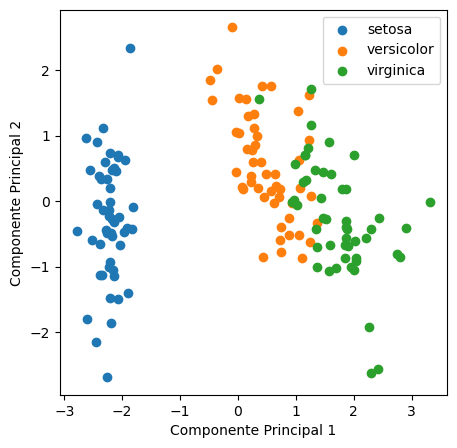

In [39]:
y = df['Species']
plt.figure(figsize=(5, 5))

for name in ('setosa', 'versicolor', 'virginica'):
    plt.scatter(data_proyectada[y==name,0], 
                -data_proyectada[y==name,1], 
                label=name)

plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")

plt.legend()
plt.show()

PLOT 3D

Varianza explicada por cada componente: [0.72962445 0.22850762 0.03668922]
Varianza total explicada: 99.48%


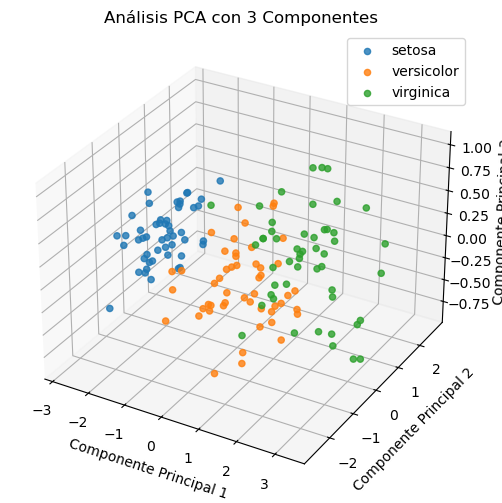

In [41]:
# Cargar datos
df = pd.read_csv(path)
X = df.iloc[:, :4]  # Filtrar las 4 columnas numéricas
y = df['Species']  # Extraer etiquetas

# Aplicar PCA con 3 componentes
pca = PCA(n_components=3)
data_proyectada = pca.fit_transform(X_std)

# Crear dataframe con los datos proyectados
df_proyectado = pd.DataFrame(data_proyectada, columns=['CP1', 'CP2', 'CP3'])
df_proyectado['Species'] = y

# Porcentaje de varianza explicada
explained_variance = pca.explained_variance_ratio_
print(f"Varianza explicada por cada componente: {explained_variance}")
print(f"Varianza total explicada: {np.sum(explained_variance) * 100:.2f}%")

# Gráfico 3D de los datos proyectados
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

# Dibujar scatterplot con las especies
for name in ('setosa', 'versicolor', 'virginica'):
    subset = df_proyectado[df_proyectado['Species'] == name]
    ax.scatter(subset['CP1'], subset['CP2'], subset['CP3'], label=name, alpha=0.8)

# Etiquetas y título
ax.set_xlabel("Componente Principal 1")
ax.set_ylabel("Componente Principal 2")
ax.set_zlabel("Componente Principal 3")
ax.set_title("Análisis PCA con 3 Componentes")
ax.legend()
plt.show()


# 2. PARTE 2: Realizar el análisis de PCA utilizando el dataset Brain_tumor, archivo Brain tumor.csv

In [67]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

#Redireccionar nuestra localización a donde està el archivo Brain Tumor
path2 = r"C:\Users\oswal\OneDrive\Documentos\GitHub\Neurociencias-2025-2\S03_datasets\Brain_tumor\Brain Tumor.csv"

In [69]:
df = pd.DataFrame({'column': ['3.14', '2.71', 'Image1']})
# Filtramos las filas que contienen valores no numéricos
df['column'] = pd.to_numeric(df['column'], errors='coerce')  # Con 'coerce', se convierten los no numéricos en NaN


In [51]:
df = pd.read_csv(path2)
df.head()

,Image,Class,Mean,Variance,Standard Deviation,Entropy,Skewness,Kurtosis,Contrast,Energy,ASM,Homogeneity,Dissimilarity,Correlation,Coarseness
0,Image1,0,6.535339,619.587845,24.891522,0.109059,4.276477,18.900575,98.613971,0.293314,0.086033,0.530941,4.473346,0.981939,7.458341e-155
1,Image2,0,8.749969,805.957634,28.389393,0.266538,3.718116,14.464618,63.858816,0.475051,0.225674,0.651352,3.220072,0.988834,7.458341e-155
2,Image3,1,7.341095,1143.808219,33.820234,0.001467,5.061750,26.479563,81.867206,0.031917,0.001019,0.268275,5.981800,0.978014,7.458341e-155
3,Image4,1,5.958145,959.711985,30.979219,0.001477,5.677977,33.428845,151.229741,0.032024,0.001026,0.243851,7.700919,0.964189,7.458341e-155
4,Image5,0,7.315231,729.540579,27.010009,0.146761,4.283221,19.079108,174.988756,0.343849,0.118232,0.501140,6.834689,0.972789,7.458341e-155


In [46]:
Z = df.iloc[:, :4]

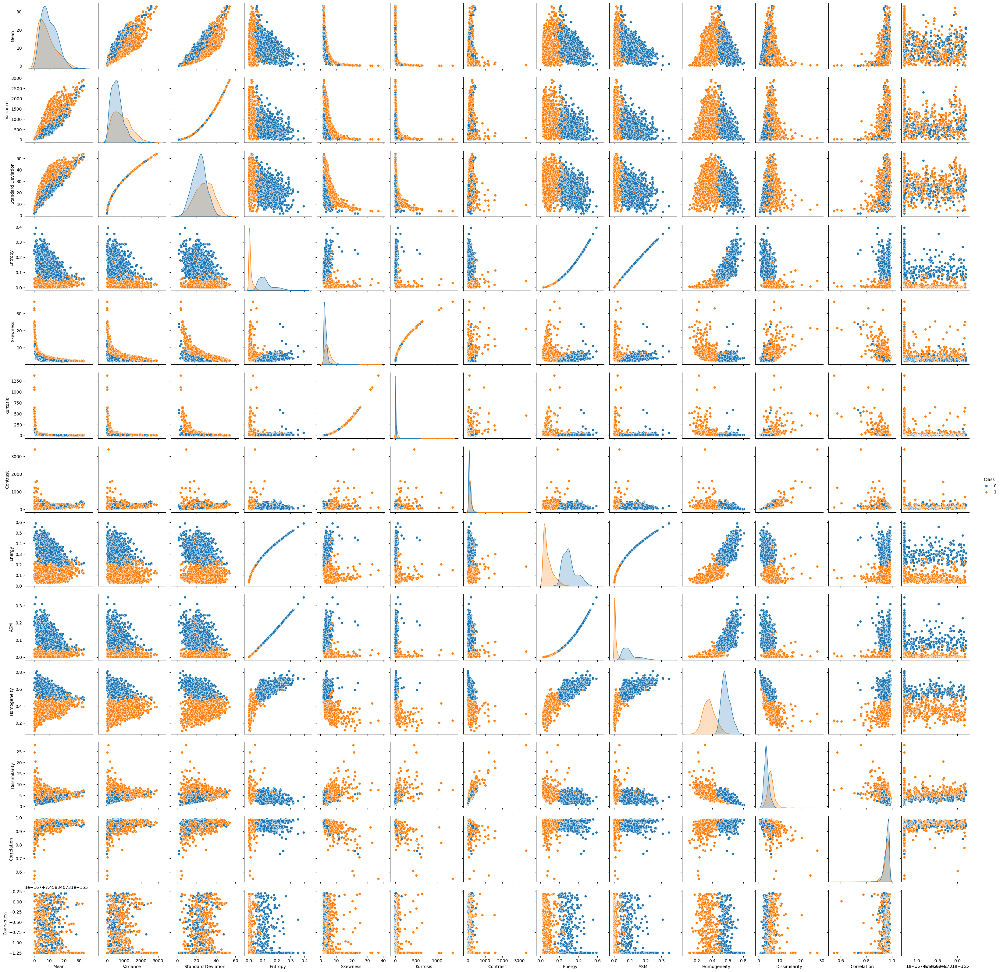

In [47]:
sns.pairplot(df, hue="Class")

1.1 Metodo 1

Componentes necesarios para al menos 90% de varianza: 4
Varianza explicada por cada componente: [4.32763571e-01 2.89082793e-01 1.22201578e-01 5.79901851e-02
 4.66411481e-02 2.07752620e-02 1.57590645e-02 8.08519247e-03
 2.58845124e-03 2.19100325e-03 1.13268047e-03 7.84886853e-04
 4.18414299e-06 0.00000000e+00]


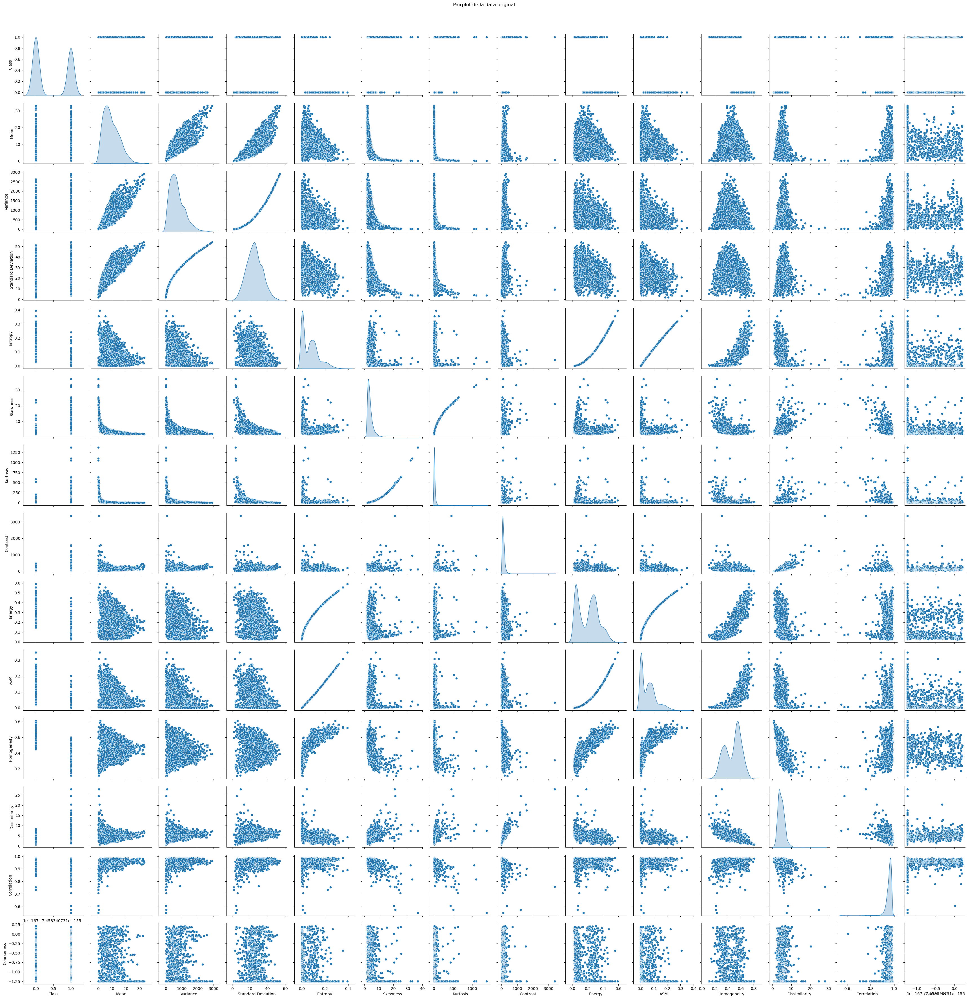

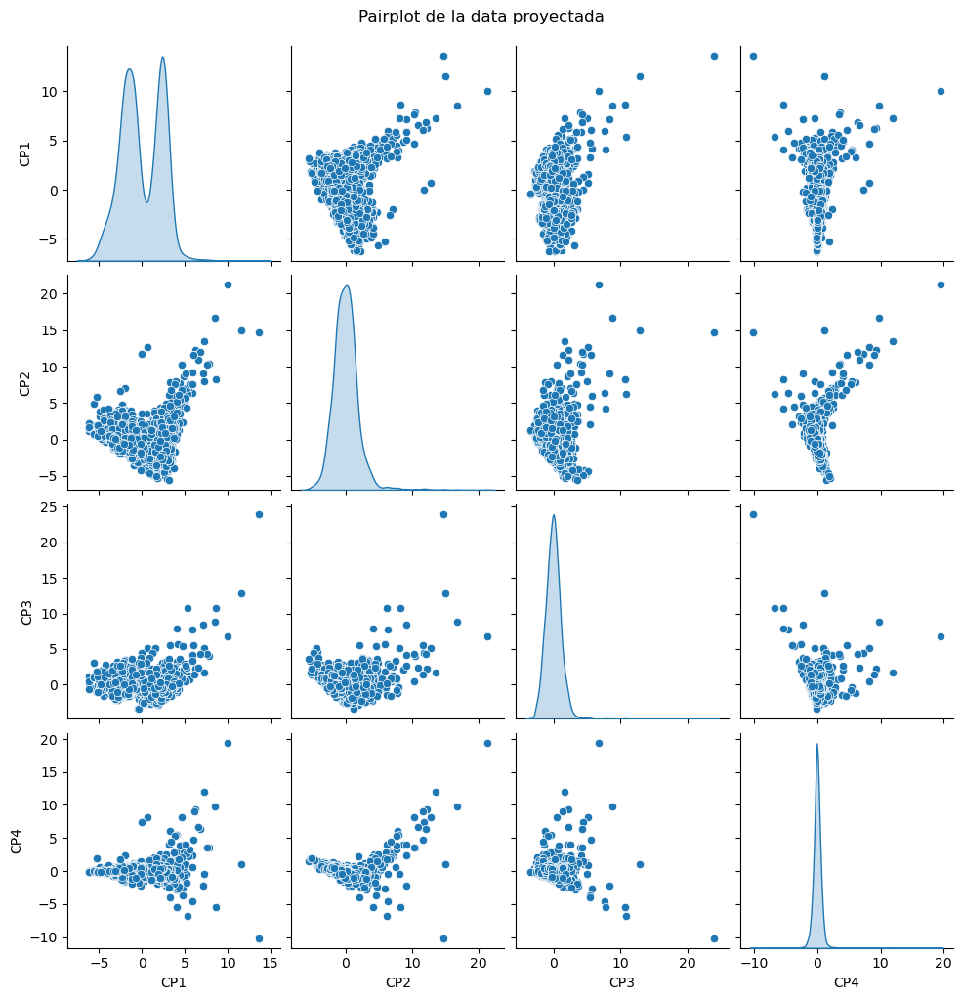

In [63]:
# Cargar datos
df = pd.read_csv(path2)

# Seleccionar solo columnas numéricas y renombrar la variable
data_numerica = df.select_dtypes(include=[np.number])

# Normalizar datos
scaler = StandardScaler()
X_std2 = scaler.fit_transform(data_numerica)

# Aplicar PCA
pca = PCA()
pca.fit(X_std2)

# Porcentaje de varianza explicada
explained_variance = np.cumsum(pca.explained_variance_ratio_)
num_components = np.argmax(explained_variance >= 0.90) + 1

print(f"Componentes necesarios para al menos 90% de varianza: {num_components}")
print(f"Varianza explicada por cada componente: {pca.explained_variance_ratio_}")

# Proyección al espacio reducido
pca_n = PCA(n_components=num_components)
data_proyectada = pca_n.fit_transform(X_std2)

# Crear dataframe con datos proyectados
df_proyectado = pd.DataFrame(data_proyectada, columns=[f'CP{i+1}' for i in range(num_components)])

# Comparación visual de pairplots
sns.pairplot(df, diag_kind='kde')
plt.suptitle("Pairplot de la data original", y=1.02)
plt.show()

sns.pairplot(df_proyectado, diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada", y=1.02)
plt.show()


1.2 Metodo 2

Componentes necesarios para al menos 90% de varianza: 4
Varianza explicada por cada componente: [4.32763571e-01 2.89082793e-01 1.22201578e-01 5.79901851e-02
 4.66411481e-02 2.07752620e-02 1.57590645e-02 8.08519247e-03
 2.58845124e-03 2.19100325e-03 1.13268047e-03 7.84886853e-04
 4.18414299e-06 0.00000000e+00]


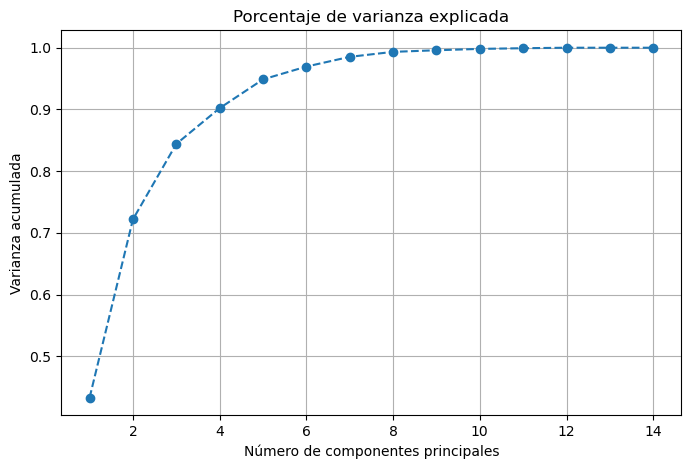

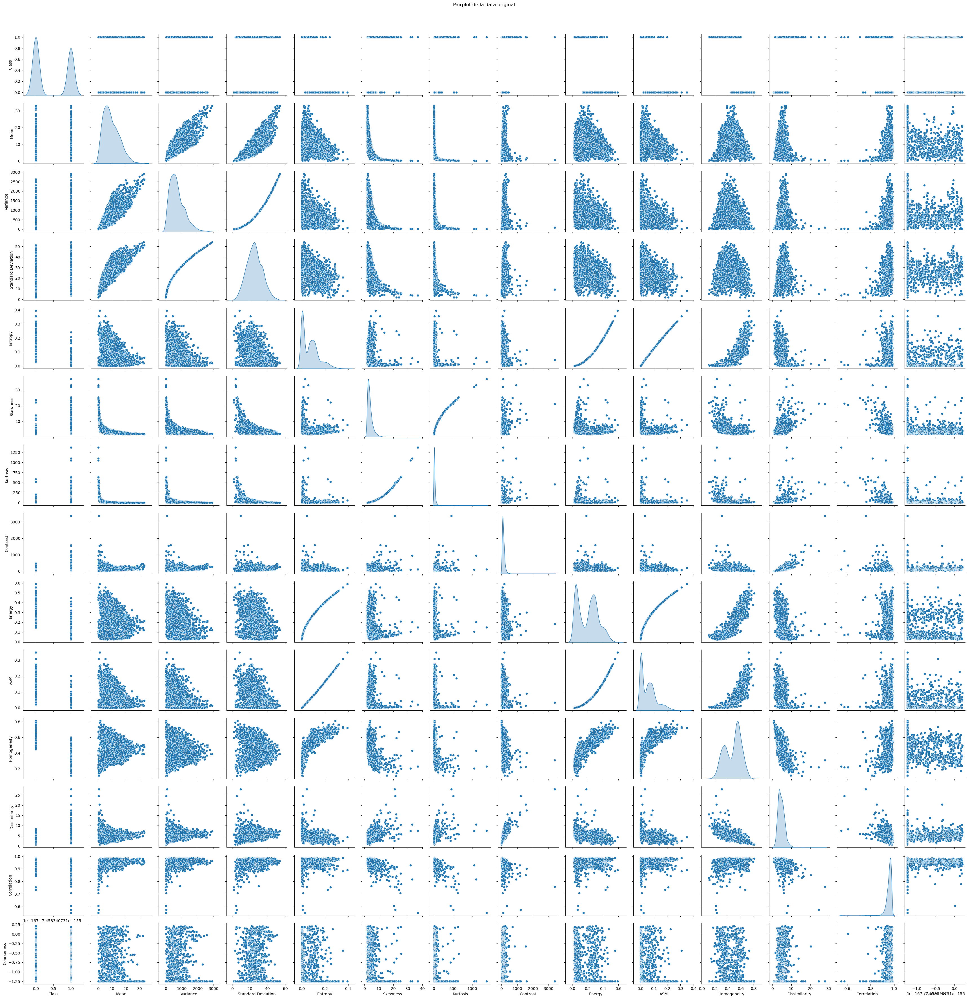

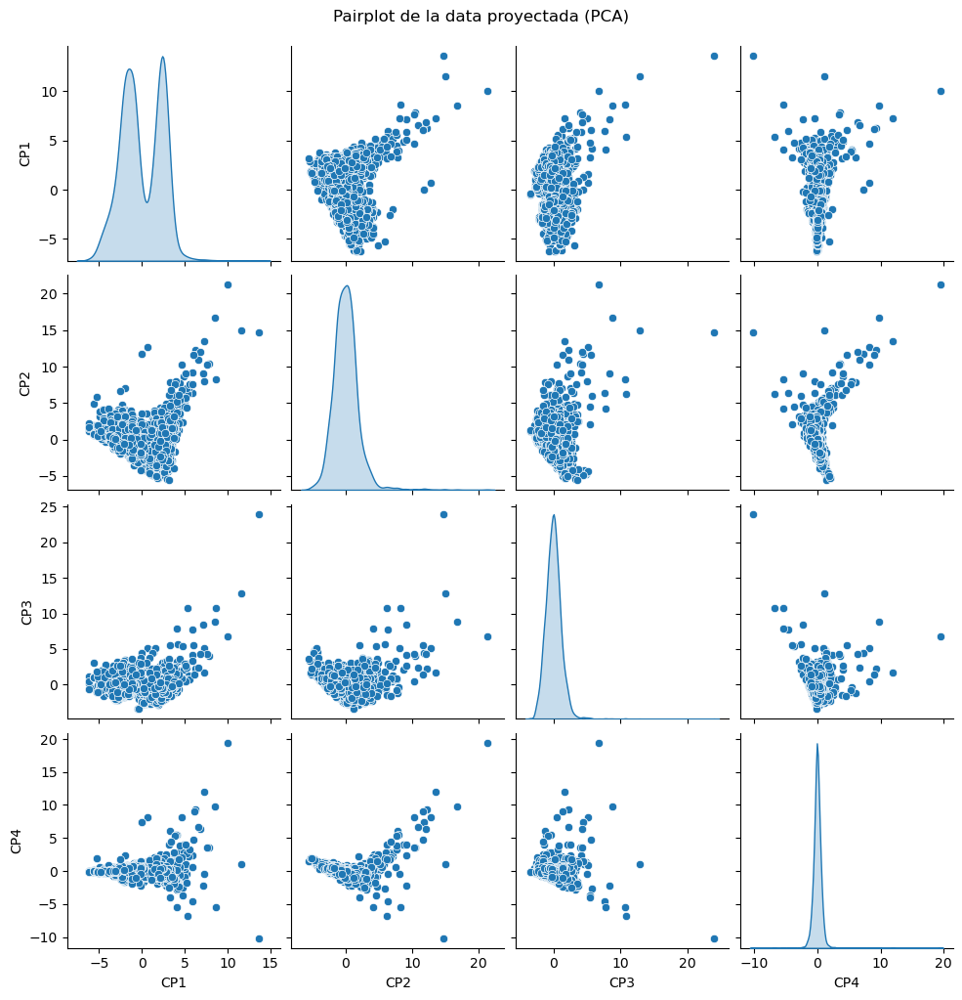

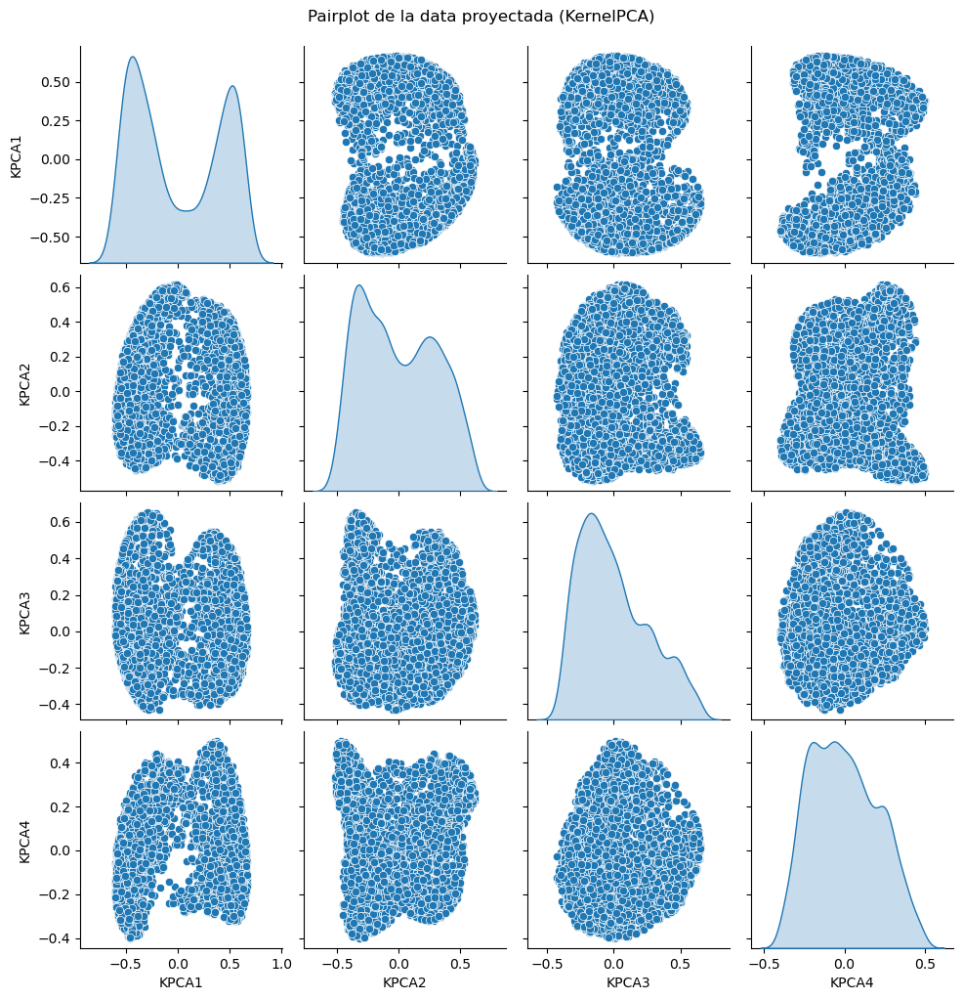

In [65]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA, KernelPCA
from sklearn.preprocessing import StandardScaler

# Cargar datos
df = pd.read_csv(path2)

# Seleccionar solo columnas numéricas y renombrar la variable
data_numerica = df.select_dtypes(include=[np.number])

# Manejo de valores faltantes (opcional, dependiendo del dataset)
data_numerica = data_numerica.dropna()

# Normalizar datos
scaler = StandardScaler()
X_std2 = scaler.fit_transform(data_numerica)

# Aplicar PCA
pca = PCA()
pca.fit(X_std2)

# Porcentaje de varianza explicada
explained_variance = np.cumsum(pca.explained_variance_ratio_)
num_components = np.argmax(explained_variance >= 0.90) + 1

print(f"Componentes necesarios para al menos 90% de varianza: {num_components}")
print(f"Varianza explicada por cada componente: {pca.explained_variance_ratio_}")

# Graficar porcentaje de varianza explicada
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(explained_variance)+1), explained_variance, marker='o', linestyle='--')
plt.title('Porcentaje de varianza explicada')
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza acumulada')
plt.grid()
plt.show()

# Proyección al espacio reducido con PCA
pca_n = PCA(n_components=num_components)
data_proyectada_pca = pca_n.fit_transform(X_std2)

# Proyección al espacio reducido con KernelPCA
kpca = KernelPCA(n_components=num_components, kernel='rbf')
data_proyectada_kpca = kpca.fit_transform(X_std2)

# Crear dataframe con datos proyectados
df_proyectado_pca = pd.DataFrame(data_proyectada_pca, columns=[f'CP{i+1}' for i in range(num_components)])
df_proyectado_kpca = pd.DataFrame(data_proyectada_kpca, columns=[f'KPCA{i+1}' for i in range(num_components)])

# Comparación visual de pairplots
sns.pairplot(df, diag_kind='kde')
plt.suptitle("Pairplot de la data original", y=1.02)
plt.show()

sns.pairplot(df_proyectado_pca, diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada (PCA)", y=1.02)
plt.show()

sns.pairplot(df_proyectado_kpca, diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada (KernelPCA)", y=1.02)
plt.show()


1.3 Metodo 3

Componentes necesarios para al menos 90% de varianza: 4
Varianza explicada por cada componente: [4.32763571e-01 2.89082793e-01 1.22201578e-01 5.79901851e-02
 4.66411481e-02 2.07752620e-02 1.57590645e-02 8.08519247e-03
 2.58845124e-03 2.19100325e-03 1.13268047e-03 7.84886853e-04
 4.18414299e-06 0.00000000e+00]


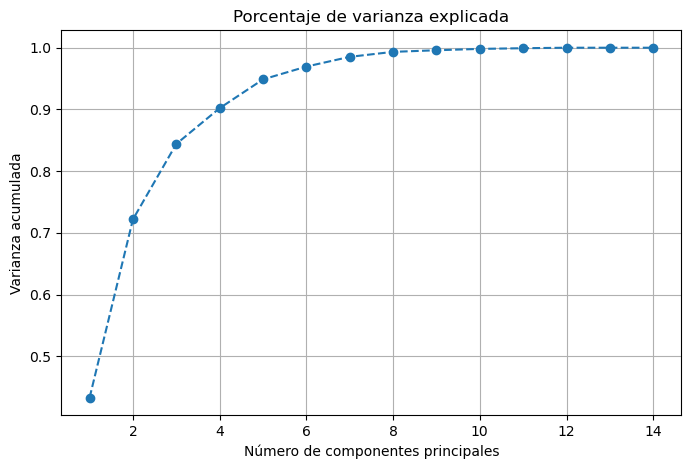

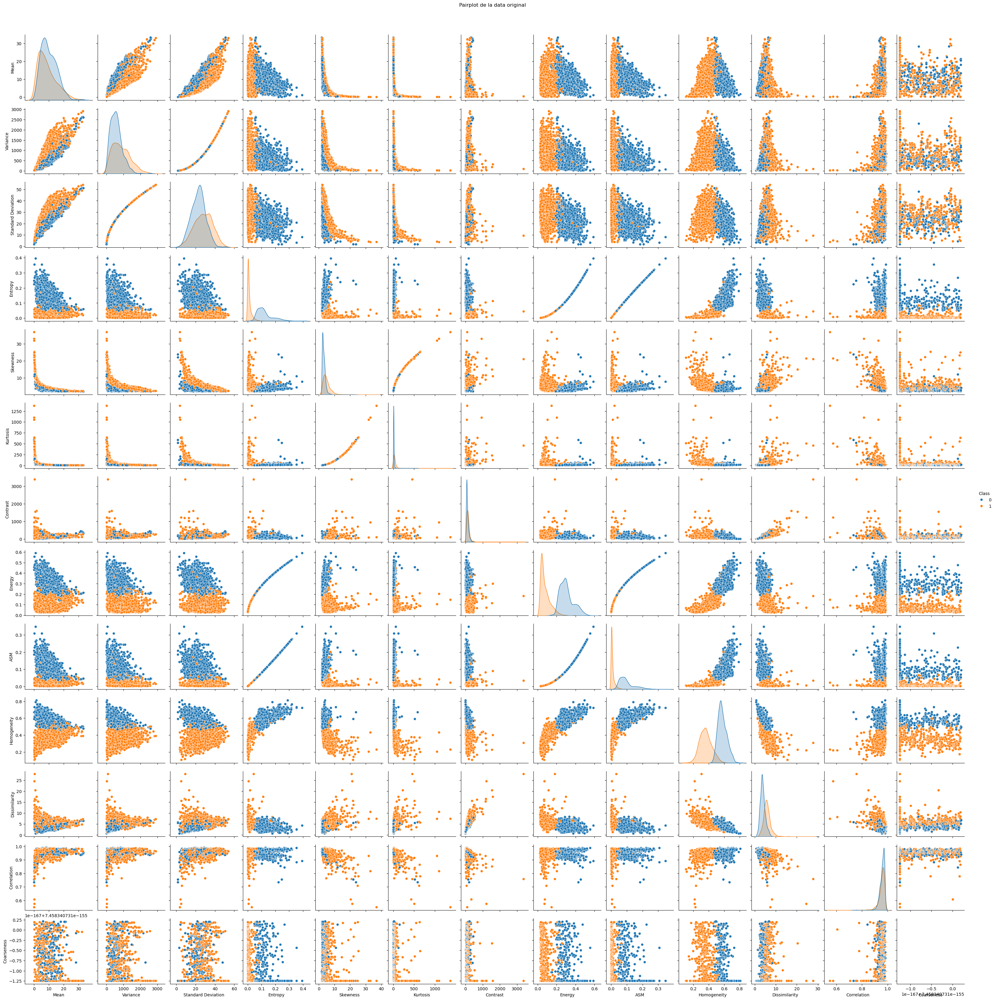

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [78]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA, KernelPCA
from sklearn.preprocessing import StandardScaler

# Cargar datos
df = pd.read_csv(path2)

# Seleccionar solo columnas numéricas y renombrar la variable
data_numerica = df.select_dtypes(include=[np.number])

# Manejo de valores faltantes (opcional, dependiendo del dataset)
data_numerica = data_numerica.dropna()

# Normalizar datos
scaler = StandardScaler()
X_std2 = scaler.fit_transform(data_numerica)

# Aplicar PCA
pca = PCA()
pca.fit(X_std2)

# Porcentaje de varianza explicada
explained_variance = np.cumsum(pca.explained_variance_ratio_)
num_components = np.argmax(explained_variance >= 0.90) + 1

print(f"Componentes necesarios para al menos 90% de varianza: {num_components}")
print(f"Varianza explicada por cada componente: {pca.explained_variance_ratio_}")

# Graficar porcentaje de varianza explicada
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(explained_variance)+1), explained_variance, marker='o', linestyle='--')
plt.title('Porcentaje de varianza explicada')
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza acumulada')
plt.grid()
plt.show()

# Proyección al espacio reducido con PCA
pca_n = PCA(n_components=num_components)
data_proyectada_pca = pca_n.fit_transform(X_std2)

# Proyección al espacio reducido con KernelPCA
kpca = KernelPCA(n_components=num_components, kernel='rbf')
data_proyectada_kpca = kpca.fit_transform(X_std2)

# Crear dataframe con datos proyectados
df_proyectado_pca = pd.DataFrame(data_proyectada_pca, columns=[f'CP{i+1}' for i in range(num_components)])
df_proyectado_kpca = pd.DataFrame(data_proyectada_kpca, columns=[f'KPCA{i+1}' for i in range(num_components)])

# Comparación visual de pairplots
sns.pairplot(df, hue='Class', diag_kind='kde')
plt.suptitle("Pairplot de la data original", y=1.02)
plt.show()

sns.pairplot(df_proyectado_pca, hue=df['Class'], diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada (PCA)", y=1.02)
plt.show()

sns.pairplot(df_proyectado_kpca, hue=df['Class'], diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada (KernelPCA)", y=1.02)
plt.show()


Componentes necesarios para al menos 90% de varianza: 4
Varianza explicada por cada componente: [4.32763571e-01 2.89082793e-01 1.22201578e-01 5.79901851e-02
 4.66411481e-02 2.07752620e-02 1.57590645e-02 8.08519247e-03
 2.58845124e-03 2.19100325e-03 1.13268047e-03 7.84886853e-04
 4.18414299e-06 0.00000000e+00]


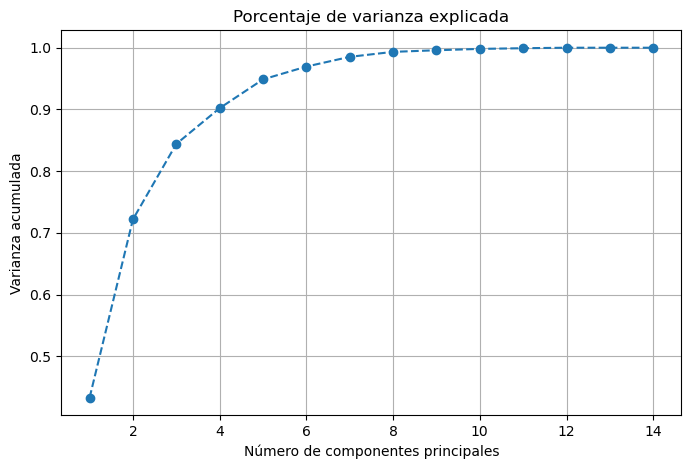

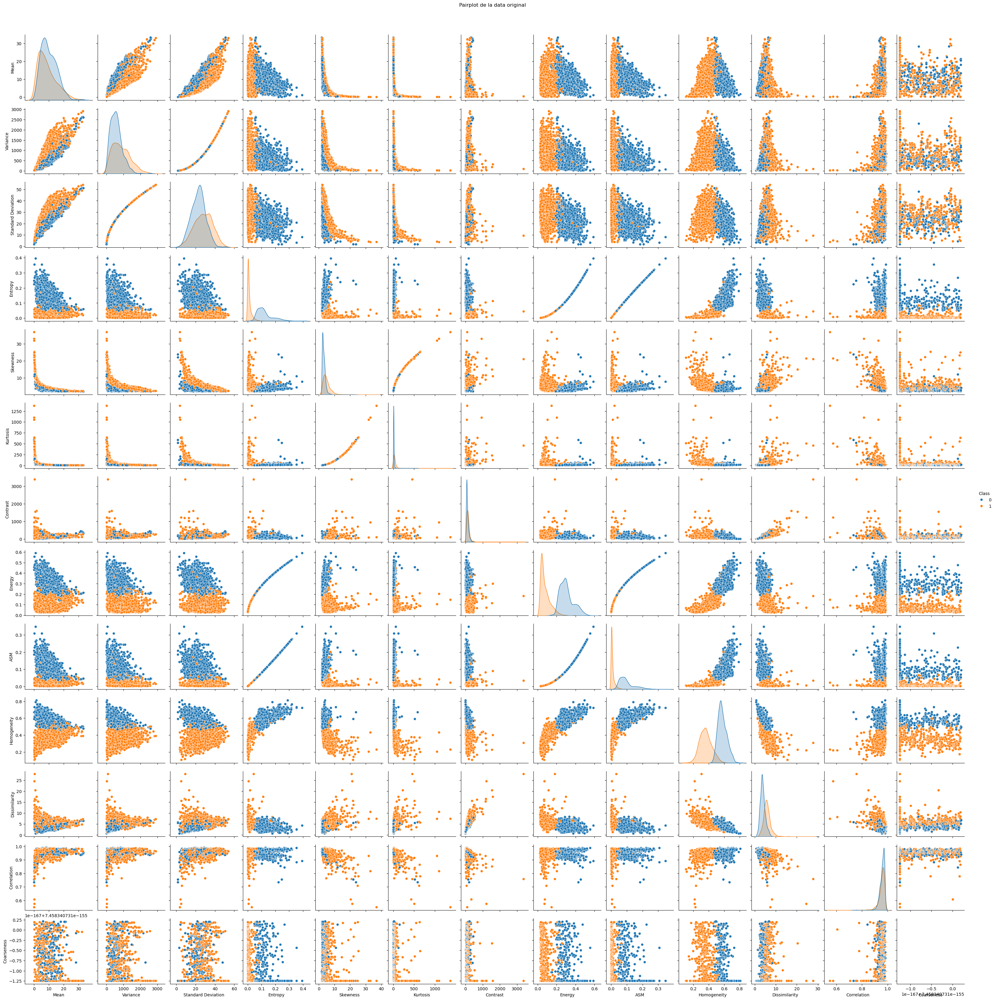

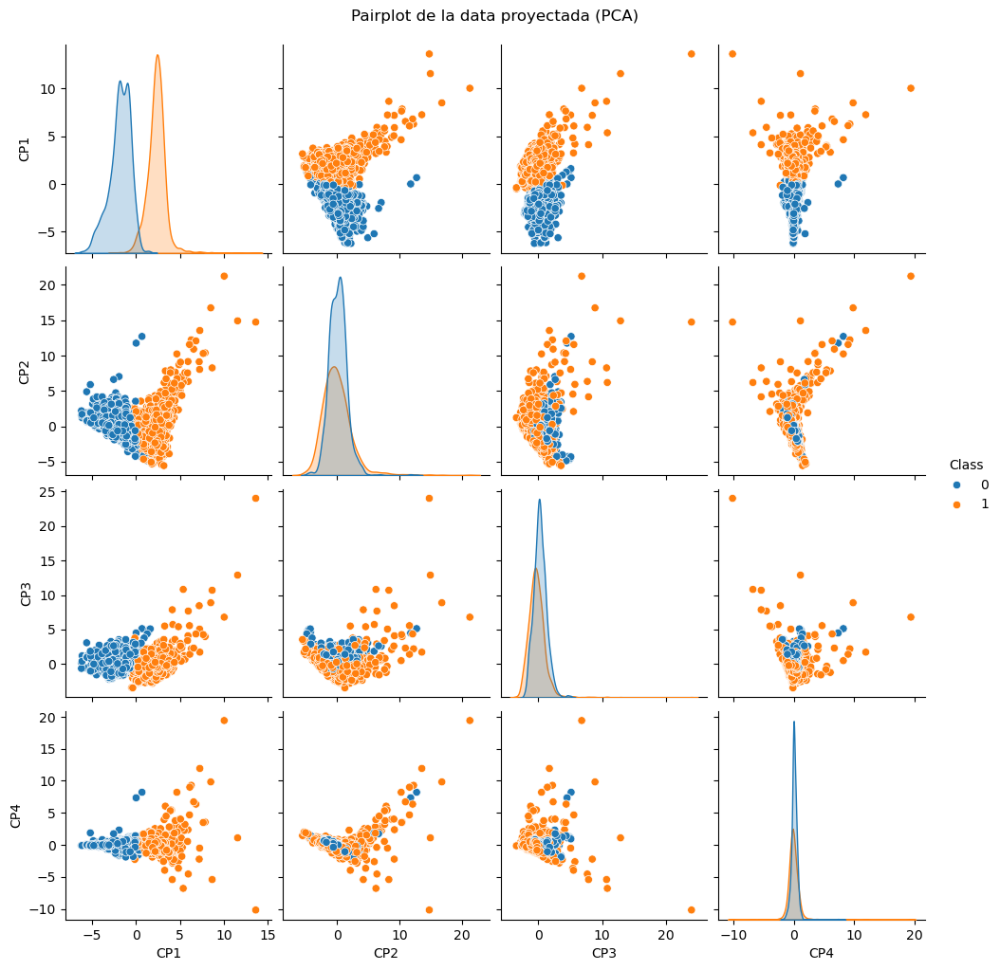

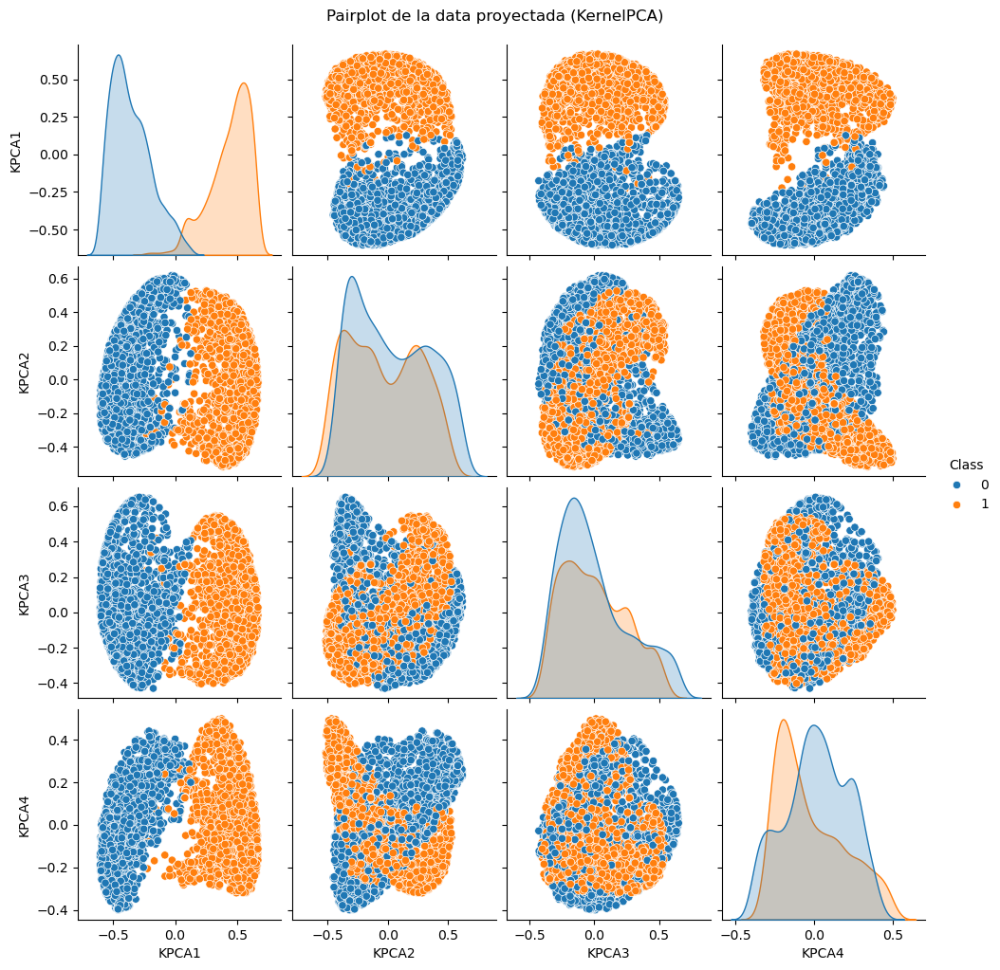

In [80]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA, KernelPCA
from sklearn.preprocessing import StandardScaler

# Cargar datos
df = pd.read_csv(path2)

# Seleccionar solo columnas numéricas y renombrar la variable
data_numerica = df.select_dtypes(include=[np.number])

# Manejo de valores faltantes (opcional, dependiendo del dataset)
data_numerica = data_numerica.dropna()

# Normalizar datos
scaler = StandardScaler()
X_std2 = scaler.fit_transform(data_numerica)

# Aplicar PCA
pca = PCA()
pca.fit(X_std2)

# Porcentaje de varianza explicada
explained_variance = np.cumsum(pca.explained_variance_ratio_)
num_components = np.argmax(explained_variance >= 0.90) + 1

print(f"Componentes necesarios para al menos 90% de varianza: {num_components}")
print(f"Varianza explicada por cada componente: {pca.explained_variance_ratio_}")

# Graficar porcentaje de varianza explicada
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(explained_variance)+1), explained_variance, marker='o', linestyle='--')
plt.title('Porcentaje de varianza explicada')
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza acumulada')
plt.grid()
plt.show()

# Proyección al espacio reducido con PCA
pca_n = PCA(n_components=num_components)
data_proyectada_pca = pca_n.fit_transform(X_std2)

# Proyección al espacio reducido con KernelPCA
kpca = KernelPCA(n_components=num_components, kernel='rbf')
data_proyectada_kpca = kpca.fit_transform(X_std2)

# Crear dataframe con datos proyectados
df_proyectado_pca = pd.DataFrame(data_proyectada_pca, columns=[f'CP{i+1}' for i in range(num_components)])
df_proyectado_kpca = pd.DataFrame(data_proyectada_kpca, columns=[f'KPCA{i+1}' for i in range(num_components)])

# Añadir columna de clase a los dataframes proyectados
df_proyectado_pca['Class'] = df['Class'].values
df_proyectado_kpca['Class'] = df['Class'].values

# Comparación visual de pairplots
sns.pairplot(df, hue='Class', diag_kind='kde')
plt.suptitle("Pairplot de la data original", y=1.02)
plt.show()

sns.pairplot(df_proyectado_pca, hue='Class', diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada (PCA)", y=1.02)
plt.show()

sns.pairplot(df_proyectado_kpca, hue='Class', diag_kind='kde')
plt.suptitle("Pairplot de la data proyectada (KernelPCA)", y=1.02)
plt.show()


In [ ]:
# En el anterior a este no jaló porque a que hue=df['Class'] no está siendo interpretado correctamente en la función sns.pairplot
#En lugar de pasar la columna hue de esta manera, necesitamos unirla correctamente al dataframe proyectado.